proj obj

### Importing Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import profile_report, ProfileReport
from sklearn.preprocessing import StandardScaler

### Reading in Data

In [2]:
df = pd.read_csv('./data/final_df.csv', index_col = 0)

# EDA and Visualizations

In [3]:
df.describe()

,totalHouseholdDebt,primaryPropertyLoanToValue,primaryPropertyValue,propertyCount,isClassADonor,isClassBDonor,isClassCDonor,isClassDDonor,NetWorth,sumClassADonation,...,maxClassBDonation,maxClassCDonation,maxClassDDonation,sumCauseADonations,sumCauseBDonations,sumCauseCDonations,sumCauseDDonations,sumCauseEDonations,rolling_avg,20k_donor
count,37687.000000,37687.000000,3.768700e+04,37687.000000,37687.000000,37687.000000,37687.000000,37687.000000,3.768700e+04,3.768700e+04,...,3.768700e+04,37687.000000,3.768700e+04,37687.000000,37687.000000,37687.000000,37687.000000,37687.000000,3.768700e+04,37687.000000
mean,4.400262,0.218777,1.247840e+06,1.392337,0.000769,0.512246,0.264176,0.185555,4.427232e+06,1.300606e+03,...,1.560802e+03,198.355294,2.121943e+02,0.271380,0.059718,0.672686,0.420020,0.008512,7.033425e+02,0.021838
std,2.060762,0.230440,1.118400e+06,0.941940,0.027729,0.499857,0.440899,0.388752,2.732548e+07,1.111470e+05,...,1.168996e+05,1738.999881,9.388645e+03,0.773807,0.344408,1.062081,0.872769,0.167259,9.934688e+03,0.146156
min,0.000000,0.000000,1.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000e+00,1.000000e+00,...,1.000000e+00,1.000000,1.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000e-02,0.000000
25%,4.505713,0.021200,6.499340e+05,1.000000,0.000000,0.000000,0.000000,0.000000,1.088610e+06,1.000000e+00,...,1.000000e+00,1.000000,1.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,2.528333e+01,0.000000
50%,5.266728,0.148094,9.376400e+05,1.000000,0.000000,1.000000,0.000000,0.000000,2.104011e+06,1.000000e+00,...,6.000000e+00,1.000000,1.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,6.250000e+01,0.000000
75%,5.609056,0.349040,1.473272e+06,2.000000,0.000000,1.000000,1.000000,0.000000,4.552962e+06,1.000000e+00,...,5.100000e+01,11.000000,1.000000e+00,0.000000,0.000000,1.491362,0.000000,0.000000,1.400000e+02,0.000000
max,7.226080,2.266596,2.756721e+07,26.000000,1.000000,1.000000,1.000000,1.000000,3.246186e+09,1.417200e+07,...,1.583275e+07,100001.000000,1.200001e+06,5.485917,4.606392,7.491976,5.996560,5.787978,1.242104e+06,1.000000


In [4]:
# 
df.profile_report()

Summarize dataset:   0%|          | 0/39 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [5]:
profile = ProfileReport(df, title='Pandas Profiling Report', explorative=True)

In [6]:
# backing up with HTML copy
# profile.to_file("df_report.html")

In [7]:
# sns.pairplot(df, corner = True)

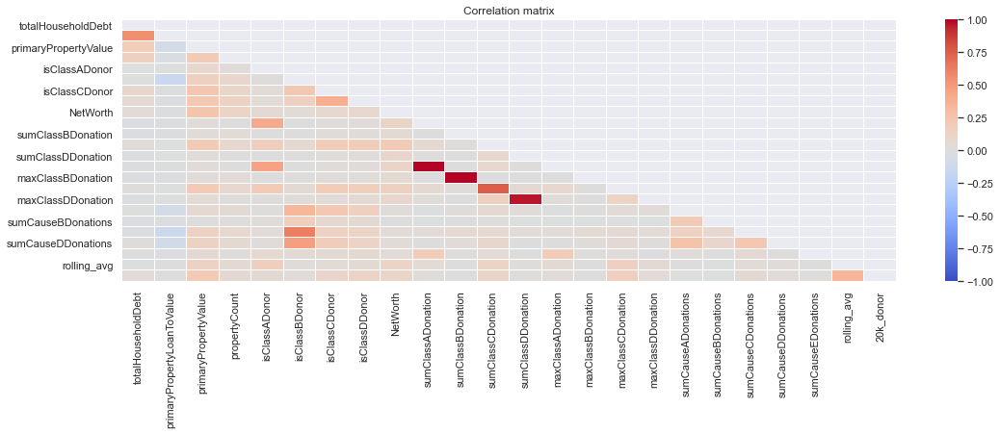

In [12]:
import matplotlib.pyplot as plt
mask = np.zeros_like(df.corr())
mask[np.triu_indices_from(mask)] = True
plt.figure(figsize=(18, 5))
sns.heatmap(
    df.corr(),
    cmap  = 'coolwarm',
    annot = False,
    mask  = mask,
    vmin  = -1.,
    vmax  = 1.,
    linewidths = .01
)
plt.title('Correlation matrix');

/Users/coreysinnott/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


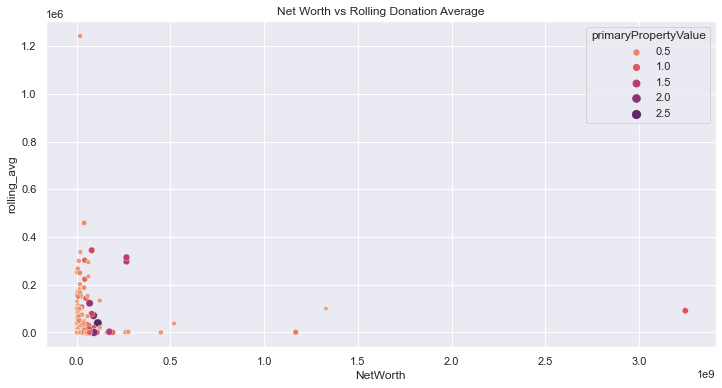

In [13]:
# outliers noted
plt.figure(figsize=(12, 6))
sns.scatterplot(df['NetWorth'], df['rolling_avg'], 
                hue = df['primaryPropertyValue'], 
                size = df['primaryPropertyValue'],
                palette='flare').set_title("Net Worth vs Rolling Donation Average");
sns.set(style='darkgrid')
#plt.show()

In [ ]:
# 